<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Parameters" data-toc-modified-id="Parameters-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Parameters</a></span></li><li><span><a href="#Data" data-toc-modified-id="Data-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Data</a></span></li><li><span><a href="#Generator" data-toc-modified-id="Generator-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Generator</a></span></li><li><span><a href="#Discriminator" data-toc-modified-id="Discriminator-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Discriminator</a></span></li><li><span><a href="#Loss-func" data-toc-modified-id="Loss-func-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Loss func</a></span></li><li><span><a href="#Training-Loop" data-toc-modified-id="Training-Loop-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Training Loop</a></span></li></ul></div>

In [15]:
import argparse
import os
import random

import matplotlib.animation as animation
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.backends.cudnn as cudnn
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from IPython.display import HTML

In [16]:
random.seed(999)
torch.manual_seed(999)

# Parameters
- dataroot : root directory
- workers : no of threads for dataloader
- batch_size 
- image_size 
- nc : no of channels in input 
- nz : Size of generator input
- ngf : Size of feature maps in generator
- ndf : Size of feature maps in discriminator
- max_epochs=5
- lr : Learning rate
- beta1 : Parameter for ADAM
- ngpu : No of GPUs

In [17]:
dataroot = "data"
workers = 2
batch_size = 128
image_size = 64
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 10
lr = .0002
beta1 = .5
ngpu = 1

# Data

In [18]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((.5, .5, .5),
                                                    (.5, .5, .5)),
                           ]))
dataloader = torch.utils.data.DataLoader(dataset,
                                         batch_size=batch_size,
                                         shuffle=True,
                                         num_workers=workers)

In [19]:
device = torch.device("cuda")

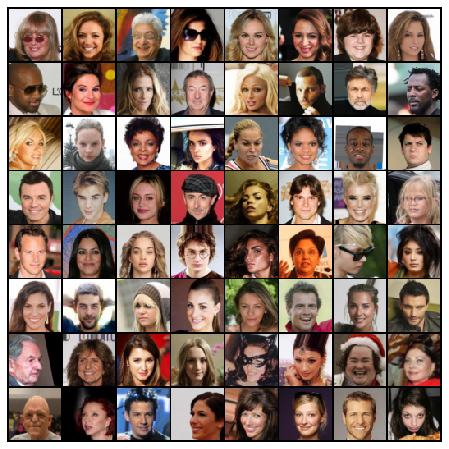

In [20]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.imshow(
    np.transpose(
        vutils.make_grid(real_batch[0].to(device)[:64],
                         padding=2,
                         normalize=True).cpu(), (1, 2,0)))

In [21]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') !=-1:
        nn.init.normal_(m.weight.data,0.0,.02)
    elif classname.find('BatchNorm') !=-1:
        nn.init.normal_(m.weight.data,1.0,.02)
        nn.init.constant_(m.bias.data,0)

# Generator

In [22]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)


In [23]:
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)


Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


# Discriminator

In [24]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [25]:
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


# Loss func

In [26]:
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))


# Training Loop

In [27]:
img_list = []
G_losses = []
D_losses = []
iters = 0

In [28]:
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1


[0/10][0/1583]	Loss_D: 1.7296	Loss_G: 6.8133	D(x): 0.7310	D(G(z)): 0.6777 / 0.0020
[0/10][50/1583]	Loss_D: 0.1412	Loss_G: 8.3749	D(x): 0.9433	D(G(z)): 0.0014 / 0.0008
[0/10][100/1583]	Loss_D: 0.5885	Loss_G: 6.7852	D(x): 0.7327	D(G(z)): 0.0043 / 0.0062
[0/10][150/1583]	Loss_D: 0.7640	Loss_G: 3.7914	D(x): 0.5528	D(G(z)): 0.0096 / 0.0335
[0/10][200/1583]	Loss_D: 0.3923	Loss_G: 4.9187	D(x): 0.8324	D(G(z)): 0.1427 / 0.0107
[0/10][250/1583]	Loss_D: 0.5937	Loss_G: 5.0023	D(x): 0.8604	D(G(z)): 0.2831 / 0.0146
[0/10][300/1583]	Loss_D: 0.4832	Loss_G: 4.0138	D(x): 0.9335	D(G(z)): 0.3007 / 0.0320
[0/10][350/1583]	Loss_D: 0.5678	Loss_G: 4.1095	D(x): 0.8594	D(G(z)): 0.2996 / 0.0297
[0/10][400/1583]	Loss_D: 0.3042	Loss_G: 5.4592	D(x): 0.8816	D(G(z)): 0.1243 / 0.0128
[0/10][450/1583]	Loss_D: 0.7235	Loss_G: 6.6729	D(x): 0.5994	D(G(z)): 0.0125 / 0.0097
[0/10][500/1583]	Loss_D: 0.4720	Loss_G: 4.1216	D(x): 0.7513	D(G(z)): 0.0785 / 0.0303
[0/10][550/1583]	Loss_D: 0.3394	Loss_G: 4.9516	D(x): 0.8261	D(G(z)):

[3/10][50/1583]	Loss_D: 0.5681	Loss_G: 2.2670	D(x): 0.7576	D(G(z)): 0.2139 / 0.1312
[3/10][100/1583]	Loss_D: 0.6789	Loss_G: 1.9054	D(x): 0.6312	D(G(z)): 0.1445 / 0.1793
[3/10][150/1583]	Loss_D: 0.8211	Loss_G: 1.4427	D(x): 0.5411	D(G(z)): 0.1028 / 0.2839
[3/10][200/1583]	Loss_D: 1.1979	Loss_G: 0.8024	D(x): 0.3755	D(G(z)): 0.0391 / 0.4979
[3/10][250/1583]	Loss_D: 0.6250	Loss_G: 2.1411	D(x): 0.7086	D(G(z)): 0.2013 / 0.1458
[3/10][300/1583]	Loss_D: 0.6589	Loss_G: 2.4793	D(x): 0.8101	D(G(z)): 0.3214 / 0.1075
[3/10][350/1583]	Loss_D: 0.7706	Loss_G: 3.2852	D(x): 0.8851	D(G(z)): 0.4433 / 0.0504
[3/10][400/1583]	Loss_D: 0.7544	Loss_G: 2.9513	D(x): 0.8079	D(G(z)): 0.3712 / 0.0701
[3/10][450/1583]	Loss_D: 0.8912	Loss_G: 2.9440	D(x): 0.8572	D(G(z)): 0.4678 / 0.0746
[3/10][500/1583]	Loss_D: 1.1929	Loss_G: 0.4135	D(x): 0.3970	D(G(z)): 0.0720 / 0.6851
[3/10][550/1583]	Loss_D: 0.6537	Loss_G: 1.4260	D(x): 0.6594	D(G(z)): 0.1609 / 0.2815
[3/10][600/1583]	Loss_D: 0.6391	Loss_G: 2.6839	D(x): 0.6909	D(G(z)

[6/10][100/1583]	Loss_D: 0.4334	Loss_G: 2.6371	D(x): 0.8380	D(G(z)): 0.2016 / 0.0917
[6/10][150/1583]	Loss_D: 0.4040	Loss_G: 2.6945	D(x): 0.8206	D(G(z)): 0.1634 / 0.0875
[6/10][200/1583]	Loss_D: 0.5955	Loss_G: 2.6814	D(x): 0.7513	D(G(z)): 0.2195 / 0.0916
[6/10][250/1583]	Loss_D: 0.9564	Loss_G: 1.4404	D(x): 0.4849	D(G(z)): 0.0543 / 0.3030
[6/10][300/1583]	Loss_D: 0.4004	Loss_G: 2.0888	D(x): 0.7766	D(G(z)): 0.1145 / 0.1502
[6/10][350/1583]	Loss_D: 0.4956	Loss_G: 2.0910	D(x): 0.7710	D(G(z)): 0.1735 / 0.1614
[6/10][400/1583]	Loss_D: 0.4471	Loss_G: 2.6738	D(x): 0.8864	D(G(z)): 0.2477 / 0.0916
[6/10][450/1583]	Loss_D: 1.5578	Loss_G: 1.0008	D(x): 0.2878	D(G(z)): 0.0500 / 0.4375
[6/10][500/1583]	Loss_D: 1.1266	Loss_G: 0.6796	D(x): 0.3839	D(G(z)): 0.0391 / 0.5644
[6/10][550/1583]	Loss_D: 0.4706	Loss_G: 2.3425	D(x): 0.8429	D(G(z)): 0.2287 / 0.1209
[6/10][600/1583]	Loss_D: 0.5593	Loss_G: 3.5075	D(x): 0.8496	D(G(z)): 0.2884 / 0.0411
[6/10][650/1583]	Loss_D: 0.5411	Loss_G: 1.6752	D(x): 0.6484	D(G(z

[9/10][150/1583]	Loss_D: 0.5163	Loss_G: 1.7897	D(x): 0.6763	D(G(z)): 0.0471 / 0.2230
[9/10][200/1583]	Loss_D: 0.3060	Loss_G: 2.8403	D(x): 0.8299	D(G(z)): 0.0893 / 0.0808
[9/10][250/1583]	Loss_D: 0.5449	Loss_G: 2.0032	D(x): 0.7091	D(G(z)): 0.1220 / 0.1712
[9/10][300/1583]	Loss_D: 0.8027	Loss_G: 1.2714	D(x): 0.5570	D(G(z)): 0.0583 / 0.3418
[9/10][350/1583]	Loss_D: 0.3589	Loss_G: 2.8515	D(x): 0.8301	D(G(z)): 0.1258 / 0.0812
[9/10][400/1583]	Loss_D: 0.3690	Loss_G: 2.6831	D(x): 0.8294	D(G(z)): 0.1320 / 0.0990
[9/10][450/1583]	Loss_D: 0.3129	Loss_G: 2.8236	D(x): 0.8105	D(G(z)): 0.0795 / 0.0909
[9/10][500/1583]	Loss_D: 1.1972	Loss_G: 3.7625	D(x): 0.9412	D(G(z)): 0.6041 / 0.0423
[9/10][550/1583]	Loss_D: 0.6246	Loss_G: 2.7841	D(x): 0.8744	D(G(z)): 0.3315 / 0.0867
[9/10][600/1583]	Loss_D: 0.4724	Loss_G: 4.0242	D(x): 0.9070	D(G(z)): 0.2804 / 0.0245
[9/10][650/1583]	Loss_D: 0.6846	Loss_G: 2.1740	D(x): 0.5866	D(G(z)): 0.0308 / 0.1609
[9/10][700/1583]	Loss_D: 0.4195	Loss_G: 3.9566	D(x): 0.9365	D(G(z

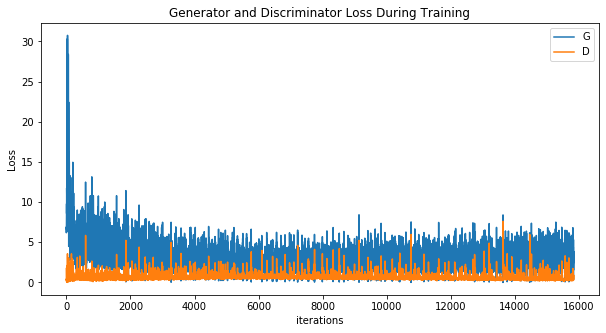

In [29]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

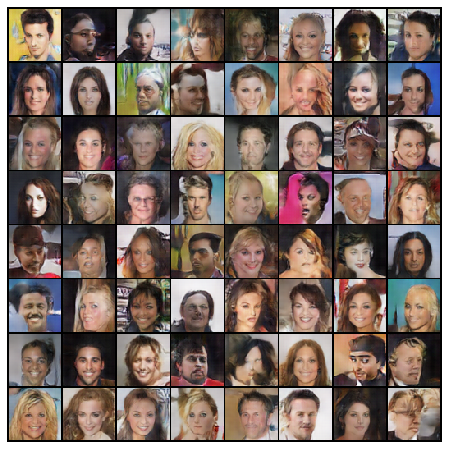

In [30]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save("anim.mp4")
HTML(ani.to_jshtml())

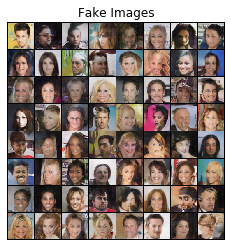

In [34]:

plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.axis('off')
# plt.show()
plt.savefig("new.png",dpi=900)